In [1]:
import sys
sys.path.append("../")

In [2]:
import pandas as pd
import plotly.graph_objects as go
from plotting import CandlePlot
import numpy as np

from simulation.pair_trade_percent_binance import PairTradePercent
from technicals.indicators import Donchian_Close

from functools import reduce

In [3]:

from multiprocessing import Process, Manager
import pickle
import warnings
warnings.filterwarnings('ignore')

In [4]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score

def filtro_melhores_parametros(df, column='strat'):
    """
    Filtra e exibe as melhores combinações de parâmetros com desempenho positivo.
    """
    
    # Lista de colunas que são parâmetros e de 'strat'
    # Excluímos colunas que não são parâmetros relevantes para o agrupamento
    param_cols = [col for col in df.columns if col not in ['pair', 'granularity', 'ema_s', 'ema_l', 'strat_real','strat', 'res', 'sig', 'c',
           'wp', 'rsi_f', 'rsi_w', 'adx_f', 'adx_w', 'max_o',
           's_p_strat', 's_n_strat', 'Rel_sum', 'l_p_strat','s_p_strat_',
           'l_n_strat', 'Rel_len', 'l_c', 'l_o', 'len_pos', 'len_neg', 'sum_pos',
           'sum_neg', 'Rel_len_pos_neg', 'Rel_pos_neg', 'first_p', 'last_p',
           'first_t', 'last_t', 'r', 'df']]
    
    # Encontrar a combinação de parâmetros com o melhor desempenho médio
    best_params_mean = df.groupby(param_cols)[column].mean().sort_values(ascending=False).reset_index()
    return best_params_mean
    
def analise_distribuicao(df, column = 'strat'):
    """
    Exibe gráficos de boxplot para mostrar a variação de retorno (strat) em relação aos principais parâmetros.
    """
    param_cols = ['ep', 'ep2', 'force', 'sl_per']
    
    for param in param_cols:
        plt.figure(figsize=(8, 6))
        df.boxplot(column=column, by=param, grid=False)
        plt.title(f'Distribuição de Retorno (strat) por Valores de {param}')
        plt.suptitle('')
        plt.xlabel(param)
        plt.ylabel(f'Retorno ({column})')
        plt.show()

def analise_sensibilidade_parametros(df):
    """
    Aplica um modelo Random Forest para calcular a importância dos parâmetros e exibe os resultados.
    """
    X = df[['ep', 'ep2', 'st', 'force', 'sl_per']]
    y = df['strat']

    # Divisão dos dados em treino e teste
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

    # Treinando o modelo Random Forest
    model = RandomForestRegressor(random_state=42, n_estimators=100)
    model.fit(X_train, y_train)

    # Avaliando o modelo no conjunto de teste
    y_pred = model.predict(X_test)
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)

    # Extraindo a importância dos parâmetros
    importance_df = pd.DataFrame({
        'Parâmetro': X.columns,
        'Importância': model.feature_importances_
    }).sort_values(by='Importância', ascending=False).reset_index(drop=True)

    print("MSE:", mse)
    print("R²:", r2)
    return importance_df




In [5]:

# def calculate_rsi(df, period=14):
#     # Calcula as diferenças dos preços de fechamento
#     df['Price Change'] = df['Close'].diff()
    
#     # Separa ganhos e perdas
#     df['Gain'] = df['Price Change'].apply(lambda x: x if x > 0 else 0)
#     df['Loss'] = df['Price Change'].apply(lambda x: -x if x < 0 else 0)
    
#     # Calcula as médias móveis exponenciais dos ganhos e perdas
#     avg_gain = df['Gain'].rolling(window=period).mean()
#     avg_loss = df['Loss'].rolling(window=period).mean()
    
#     # Calcula o RSI
#     rs = avg_gain / avg_loss
#     df['RSI'] = 100 - (100 / (1 + rs))
    
#     # Limpa colunas temporárias
#     df.drop(columns=['Price Change', 'Gain', 'Loss'], inplace=True)
    
#     return df




# def calculate_adx(df, period=14):
#     # Cálculo de +DM, -DM e TR
#     df['High-Low'] = df['High'] - df['Low']
#     df['High-Close'] = abs(df['High'] - df['Close'].shift(1))
#     df['Low-Close'] = abs(df['Low'] - df['Close'].shift(1))
    
#     df['TR'] = df[['High-Low', 'High-Close', 'Low-Close']].max(axis=1)
#     df['+DM'] = np.where((df['High'] - df['High'].shift(1)) > (df['Low'].shift(1) - df['Low']), 
#                          np.maximum(df['High'] - df['High'].shift(1), 0), 0)
#     df['-DM'] = np.where((df['Low'].shift(1) - df['Low']) > (df['High'] - df['High'].shift(1)), 
#                          np.maximum(df['Low'].shift(1) - df['Low'], 0), 0)
    
#     # Suavizando os valores de TR, +DM e -DM com média móvel exponencial
#     df['TR_smooth'] = df['TR'].rolling(window=period).sum()
#     df['+DM_smooth'] = df['+DM'].rolling(window=period).sum()
#     df['-DM_smooth'] = df['-DM'].rolling(window=period).sum()
    
#     # Cálculo de +DI e -DI
#     df['+DI'] = 100 * (df['+DM_smooth'] / df['TR_smooth'])
#     df['-DI'] = 100 * (df['-DM_smooth'] / df['TR_smooth'])
    
#     # Cálculo do DX
#     df['DX'] = 100 * abs(df['+DI'] - df['-DI']) / (df['+DI'] + df['-DI'])
    
#     # Cálculo do ADX
#     df['ADX'] = df['DX'].rolling(window=period).mean()

#     # Limpando colunas temporárias
#     df.drop(columns=['High-Low', 'High-Close', 'Low-Close', 'TR', '+DM', '-DM', 'TR_smooth', '+DM_smooth', '-DM_smooth', 'DX'], inplace=True)

#     return df
    
# # Função para calcular a variação percentual acumulada
# def calculate_percent_change(close_prices, window):
#     percent_change = np.zeros(len(close_prices))

#     for i in range(window, len(close_prices)):
#         window_sum = 0.0
#         for j in range(i - window + 1, i + 1):
#             percent_change[j] = (close_prices[j] - close_prices[j - 1]) / close_prices[j - 1] * 100
#             window_sum += percent_change[j]
#         percent_change[i] = window_sum

#     return percent_change


# Função para calcular a variação percentual acumulada com uma janela deslizante correta
def calculate_percent_change(close_prices, window):
    percent_change = np.zeros(len(close_prices))

    for i in range(window, len(close_prices)):
        window_sum = 0.0
        for j in range(i - window + 1, i + 1):
            # Calcula a variação percentual entre o ponto atual e o ponto anterior
            change = (close_prices[j] - close_prices[j - 1]) / close_prices[j - 1] * 100
            window_sum += change
        # Atribui o valor acumulado da janela atual ao ponto final da janela
        percent_change[i] = window_sum

    return percent_change



# Função para calcular a EMA
def calculate_ema(values, period):
    ema = np.zeros(len(values))
    multiplier = 2 / (period + 1)
    ema[period - 1] = values[period - 1]  # O primeiro valor da EMA é igual ao valor inicial
    for i in range(period, len(values)):
        ema[i] = (values[i] - ema[i - 1]) * multiplier + ema[i - 1]
    return ema

# Função para calcular os indicadores e adicionar ao DataFrame
def calculate_indicators(df, window=14, ema_period_1=10, ema_period_2=60):
    
    # Obtém os preços de fechamento da coluna 'mid_c'
    close_prices = df['EMA_short'].values
    # close_prices = df['cLog_Returns'].values
    
    # Calcula a variação percentual acumulada
    percent_change = calculate_percent_change(close_prices, window)

    # Calcula as EMAs
    ema_1 = calculate_ema(percent_change, ema_period_1)
    ema_ema_1 = calculate_ema(ema_1, ema_period_2)
    # ema_2 = calculate_ema(percent_change, ema_period_2)

    # Adiciona os resultados ao DataFrame original
    df['Percent_Change'] = percent_change
    df['EMA_percent_s'] = ema_1
    df['double_EMA_percent_s'] = ema_ema_1
    # df['EMA_percent_l'] = ema_2

    return df


# Função para calcular os indicadores e adicionar ao DataFrame
def calculate_emaper(df, window=14):
    
    # Obtém os preços de fechamento da coluna 'mid_c'
    close_prices = df['EMA_short'].values
    # close_prices = df['cLog_Returns'].values
    
    # Calcula a variação percentual acumulada
    percent_change = calculate_percent_change(close_prices, window)

    # Calcula as EMAs
    # ema_1 = calculate_ema(percent_change, ema_period_1)
    # ema_ema_1 = calculate_ema(ema_1, ema_period_2)
    # ema_2 = calculate_ema(percent_change, ema_period_2)

    # # Adiciona os resultados ao DataFrame original
    # df['Percent_Change'] = percent_change
    # df['EMA_percent_s'] = ema_1
    # df['double_EMA_percent_s'] = ema_ema_1
    # df['EMA_percent_l'] = ema_2

    return percent_change
    


import pandas as pd
import numpy as np

def calculate_rsi(df, period=14):
    # Calcula as diferenças dos preços de fechamento
    delta = df['Close'].diff()
    
    # Separa ganhos e perdas
    gain = np.where(delta > 0, delta, 0)
    loss = np.where(delta < 0, -delta, 0)
    
    # Usa a média móvel exponencial para suavizar os ganhos e perdas
    avg_gain = pd.Series(gain).ewm(alpha=1/period, min_periods=period).mean()
    avg_loss = pd.Series(loss).ewm(alpha=1/period, min_periods=period).mean()
    
    # Calcula o RSI
    rs = avg_gain / avg_loss
    rsi = 100 - (100 / (1 + rs))
    
    # Adiciona o RSI ao DataFrame e retorna
    df['RSI'] = rsi
    return df

def calculate_adx(df, period=14):
    # Calcula +DM, -DM e TR
    high_diff = df['High'].diff()
    low_diff = df['Low'].diff()
    df['+DM'] = np.where((high_diff > low_diff) & (high_diff > 0), high_diff, 0)
    df['-DM'] = np.where((low_diff > high_diff) & (low_diff > 0), low_diff, 0)
    df['TR'] = np.maximum(df['High'] - df['Low'], 
                          np.maximum(abs(df['High'] - df['Close'].shift(1)), 
                                     abs(df['Low'] - df['Close'].shift(1))))

    # Suaviza TR, +DM e -DM com a média móvel exponencial
    atr = df['TR'].ewm(alpha=1/period, min_periods=period).mean()
    df['+DI'] = 100 * (df['+DM'].ewm(alpha=1/period, min_periods=period).mean() / atr)
    df['-DI'] = 100 * (df['-DM'].ewm(alpha=1/period, min_periods=period).mean() / atr)
    
    # Calcula o DX e o ADX
    dx = 100 * abs(df['+DI'] - df['-DI']) / (df['+DI'] + df['-DI'])
    df['ADX'] = dx.ewm(alpha=1/period, min_periods=period).mean()

    # Remove colunas temporárias
    df.drop(columns=['+DM', '-DM', 'TR'], inplace=True)
    
    return df


In [6]:
def run_pair(pair,
             granularity,
             ema_s=10,
             ema_l=200,
             lenght=10000,
             window_percent=100,
            ema_percent1=100,
            ema_percent2=100,
             strategy=1,
             EMA_percent_s_force=0.01,
             stop_loss_percent=-0.02,
             rsi_force=70,
             rsi_window=50,
             adx_force=20,
             adx_window=50,
             ema_percent_super_long=1000
            ):
    df = pd.read_pickle(f"crypto/{pair}_{granularity}.pkl")
    df['time'] = df['Time'].copy()
    df['strategy'] = 0
    # dff['returns'] = dff['Close'].pct_change()
    df['returns'] = np.log(df['Close'] / df['Close'].shift(1))
    df['creturns'] = df['returns'].cumsum()
    df['Log_Returns'] = np.log(df['Close'] / df['Close'].shift(1))
    df['cLog_Returns'] = df['Log_Returns'].cumsum()

    # df = df.iloc[lenght:]
    df = df[df['Time'] >= lenght]

    df['EMA_short'] = df.Close.ewm(span=ema_s, min_periods=ema_s).mean()
    df['EMA_long'] = df.Close.ewm(span=ema_l, min_periods=ema_l).mean()

    df['EMA_long_delta'] = df['Close'] - df['EMA_long']

    df.dropna(inplace=True)
    df.reset_index(drop=True, inplace=True)
    
    # df = calculate_indicators(df, window_percent, ema_percent1, ema_percent2)

    # df['Percent_Change'] = calculate_emaper(df, window_percent)
    # df['EMA_percent_s'] = calculate_ema(df['Percent_Change'].values, ema_percent1)
    # df['double_EMA_percent_s'] =  calculate_ema(df['EMA_percent_s'].values,ema_percent2)

    df['Percent_Change_1'] = calculate_emaper(df, 1)
    df['EMA_percent_s_1'] = calculate_ema(df['Percent_Change_1'].values, 10)

    df['Percent_Change_super_long'] = calculate_emaper(df, ema_percent_super_long)
    df['Average_EMA_percent_ema_super_long'] = calculate_ema(df['Percent_Change_super_long'].values, 200)
    
    # df['Percent_Change_10'] = calculate_emaper(df, 10)
    # df['EMA_percent_s_10'] = calculate_ema(df['Percent_Change_10'].values, 10)

    # df['Percent_Change_50'] = calculate_emaper(df, 50)
    # df['EMA_percent_s_50'] = calculate_ema(df['Percent_Change_50'].values, 10)

    # df['Percent_Change_100'] = calculate_emaper(df, 100)
    # df['EMA_percent_s_100_5'] = calculate_ema(df['Percent_Change_100'].values, 5)
    # df['EMA_percent_s_100_10'] = calculate_ema(df['Percent_Change_100'].values, 10)
    # df['EMA_percent_s_100_15'] = calculate_ema(df['Percent_Change_100'].values, 15)
    
    # df['Percent_Change_150'] = calculate_emaper(df, 150)
    # df['EMA_percent_s_150_5'] = calculate_ema(df['Percent_Change_150'].values, 5)
    # df['EMA_percent_s_150_10'] = calculate_ema(df['Percent_Change_150'].values, 10)
    # df['EMA_percent_s_150_15'] = calculate_ema(df['Percent_Change_150'].values, 15)

    # df['Percent_Change_200'] = calculate_emaper(df, 200)
    # df['EMA_percent_s_200_5'] = calculate_ema(df['Percent_Change_200'].values, 5)
    # df['EMA_percent_s_200_10'] = calculate_ema(df['Percent_Change_200'].values, 10)
    # df['EMA_percent_s_200_15'] = calculate_ema(df['Percent_Change_200'].values, 15)

    # df['Percent_Change_500'] = calculate_emaper(df, 500)
    # df['EMA_percent_s_500_5'] = calculate_ema(df['Percent_Change_500'].values, 5)

    # df['Percent_Change_1000'] = calculate_emaper(df, 1000)
    # df['EMA_percent_s_1000_5'] = calculate_ema(df['Percent_Change_1000'].values, 5)
    # df['EMA_percent_s_1000_20'] = calculate_ema(df['Percent_Change_1000'].values, 20)
    # df['EMA_percent_s_1000_50'] = calculate_ema(df['Percent_Change_1000'].values, 50)
    # df['EMA_percent_s_1000_100'] = calculate_ema(df['Percent_Change_1000'].values, 100)

    # df['Percent_Change_2000'] = calculate_emaper(df, 2000)
    # df['EMA_percent_s_2000_5'] = calculate_ema(df['Percent_Change_2000'].values, 5)
    # df['EMA_percent_s_2000_20'] = calculate_ema(df['Percent_Change_2000'].values, 20)
    # df['EMA_percent_s_2000_50'] = calculate_ema(df['Percent_Change_2000'].values, 50)
    # df['EMA_percent_s_2000_100'] = calculate_ema(df['Percent_Change_2000'].values, 100)

    # df['Percent_Change_3000'] = calculate_emaper(df, 3000)
    # df['EMA_percent_s_3000_5'] = calculate_ema(df['Percent_Change_3000'].values, 5)
    # df['EMA_percent_s_3000_20'] = calculate_ema(df['Percent_Change_3000'].values, 20)
    # df['EMA_percent_s_3000_50'] = calculate_ema(df['Percent_Change_3000'].values, 50)
    # df['EMA_percent_s_3000_100'] = calculate_ema(df['Percent_Change_3000'].values, 100)
    
    # df['Average_EMA_percent'] = df[['EMA_percent_s_100_10', 'EMA_percent_s_150_10', 'EMA_percent_s_200_10']].mean(axis=1)
    # df['Average_EMA_percent_ema_short'] = calculate_ema(df['Average_EMA_percent'].values, ema_percent1)
    # df['Average_EMA_percent_ema_long'] = calculate_ema(df['Average_EMA_percent'].values, ema_percent2)
    # df['Average_EMA_percent_ema_1'] = calculate_ema(df['Average_EMA_percent'].values, 1)
    # df['Average_EMA_percent_ema_5'] = calculate_ema(df['Average_EMA_percent'].values, 5)
    # df['Average_EMA_percent_ema_50'] = calculate_ema(df['Average_EMA_percent'].values, 50)
    # df['Average_EMA_percent_ema_100'] = calculate_ema(df['Average_EMA_percent'].values, 100)

    df = Donchian_Close(df, window_percent)
    
    df = calculate_adx(df, adx_window)
    df = calculate_rsi(df, rsi_window)
    
    df.dropna(inplace=True)
    
    df.reset_index(drop=True, inplace=True)


    

    
    gt = PairTradePercent(
        df,
        strategy,
        EMA_percent_s_force,
        stop_loss_percent,
        rsi_force,
        adx_force
    )
    
    gt.run_test()
    return gt
    

In [7]:
# df = run_pair(pair='BTCUSDT', 
#               granularity='1m', 
#               ema=10,
#               lenght=10000, 
#               pairs_trade_benchmark = ["BTCUSDT",'ETHUSDT','BNBUSDT','LTCUSDT'],
#             window_percent=100,
#             ema_percent1=100,
#             ema_percent2=100,)


In [8]:
# df.columns

In [9]:
# pairs = ["ADAUSDT","BTCUSDT",'ETHUSDT','BNBUSDT','XRPUSDT','LTCUSDT']
# pairs = ['ADAUSDT','LINKUSDT']
# pairs = ['DOTUSDT','DOGEUSDT','ADAUSDT','XRPUSDT','TRXUSDT','XLMUSDT','APTUSDT','VIDTUSDT']
pairs = ['DOTUSDT']

In [10]:
def get_list_args():
    args_dic_list = []
    for ema_s in [20]:
        for ema_l in [2000]:
            for pair in pairs:
                for granularity in ['1m']:
                    for lenght in ['2023-01-01 00:00:00']:
                        for window_percent in [500]:
                            for ema_percent1 in [5]:
                                for ema_percent2 in [50]:
                                    if ema_percent1 < ema_percent2:
                                        for EMA_percent_s_force in [2]:
                                            for stop_loss_percent in [-0.1]:
                                                for strategy in [22]:#,11,12]:
                                                    rsi_forces = [50]
                                                    rsi_windows = [50]
                                                    adx_forces = [20]
                                                    adx_windows = [50]
                                                    if strategy in [1,2,3,14]:
                                                        rsi_forces, rsi_windows, adx_forces, adx_windows = [10], [10], [10], [10]
                                                    elif strategy in [4,6,8]:
                                                        adx_forces, adx_windows = [10], [10]
                                                    elif strategy in [5,7,9]:
                                                        rsi_forces, rsi_windows = [10], [10]
                                                    for rsi_force in rsi_forces:
                                                        for rsi_window in rsi_windows:
                                                            for adx_force in adx_forces:
                                                                for adx_window in adx_windows:
                                                                    for ema_percent_super_long in [2000]:
                                                                        args_dic = {"pair": pair,
                                                                                    "granularity":granularity,
                                                                                    'ema_s': ema_s,
                                                                                    'ema_l': ema_l,
                                                                                    'lenght': lenght,
                                                                                    'window_percent': window_percent,
                                                                                   'ema_percent1': ema_percent1,
                                                                                   'ema_percent2': ema_percent2,
                                                                                    'strategy':strategy,
                                                                                   'EMA_percent_s_force':EMA_percent_s_force,
                                                                                    'stop_loss_percent':stop_loss_percent,
                                                                                   'rsi_force': rsi_force,
                                                                                   'rsi_window':rsi_window,
                                                                                   'adx_force': adx_force,
                                                                                   'adx_window':adx_window,
                                                                                   'ema_percent_super_long':ema_percent_super_long}
                                                                        args_dic_list.append(args_dic)

    return args_dic_list

In [11]:

def run_process(L, arg):
    # print("PROCESS",arg)
    L.append(
        dict(
            arg=arg,
            pair=arg['pair'],
            granularity=arg['granularity'],
            ema_s=arg['ema_s'],
            ema_l=arg['ema_l'],
            lenght = arg['lenght'],
            window_percent = arg['window_percent'],
            ema_percent1 = arg['ema_percent1'],
            ema_percent2 = arg['ema_percent2'],
            stop_loss_percent = arg['stop_loss_percent'],
            strategy = arg['strategy'],
            rsi_force = arg['rsi_force'],
            rsi_window = arg['rsi_window'],
            adx_force = arg['adx_force'],
            adx_window = arg['adx_window'],
            ema_percent_super_long=arg['ema_percent_super_long'],
            res=run_pair(
                pair=arg['pair'],
                granularity=arg['granularity'],
                ema_s=arg['ema_s'],
                ema_l=arg['ema_l'],
                lenght = arg['lenght'],
                window_percent = arg['window_percent'],
                ema_percent1 = arg['ema_percent1'],
                ema_percent2= arg['ema_percent2'],
                strategy= arg['strategy'],
                EMA_percent_s_force=arg['EMA_percent_s_force'],
                stop_loss_percent=arg['stop_loss_percent'],
                rsi_force = arg['rsi_force'],
                rsi_window = arg['rsi_window'],
                adx_force=  arg['adx_force'],
                adx_window = arg['adx_window'],
                ema_percent_super_long = arg['ema_percent_super_long']
            )
        )
    )


lista = []
def run_ema_macd():
    with Manager() as manager:
        global lista
        L = manager.list()  # <-- can be shared between processes.
        args_list = get_list_args()
        print(len(args_list))
        limit = 10
        current = 0
    
        while current < len(args_list):
            print(current)
            processes = []
            todo = len(args_list) - current
            if todo < limit:
                limit = todo
    
            for _ in range(limit):
                processes.append(Process(target=run_process, args=(L,args_list[current])))
                current += 1
    
            for p in processes:
                p.start()
    
            for p in processes:
                p.join()

        print("ALL DONE")
        lista = list(L)
        

In [ ]:
%%time

run_ema_macd()

1
0


In [13]:
# with open(f"./result-binance-acumulative-percentual-st-14ssss.pkl", "wb") as f:
#     pickle.dump(lista, f)  # Usa o pickle para salvar o arquivo


# with open(f"result-binance-acumulative-percentual-new-data-strategy-14-1min-2022.pkl", "rb") as f:
#     res = pickle.load(f)

In [14]:
# ddf.columns

In [15]:
# ddf.describe()

In [34]:
res = lista


In [35]:

dic_res = []
for r in res:

    if r['res'].len_close > 0:
        signal_up = r['res'].df_results.SIGNAL_UP.values[-1]

        res_pos_s = r['res'].df_results[r['res'].df_results['strategy_real'] > 0]
        res_neg_s = r['res'].df_results[r['res'].df_results['strategy_real'] <= 0]
        sum_neg_s = res_neg_s.strategy_real.sum() *-1
        sum_pos_s = res_pos_s.strategy_real.sum()
        sum_pos_s_ = res_pos_s.strategy.sum()
        dic_res.append(
            dict(
                pair = r['pair'],
                granularity = r['granularity'],
                ema_s = r['ema_s'],
                ema_l = r['ema_l'],
                strat_real = round(r['res'].df_results.strategy_real.sum(),3),
                strat = round(r['res'].df_results.strategy.sum(),3),
                res = round(r['res'].df_results.result.sum(),3),
                sig = signal_up,
                c = r['res'].df_results['count'].mean(),
                wp = r['window_percent'],
                ep = r['ema_percent1'],
                ep2 = r['ema_percent2'],
                percent_super_long = r['ema_percent_super_long'],
                # rsi_f = r['rsi_force'],
                # rsi_w = r['rsi_window'],
                # adx_f = r['adx_force'],
                # adx_w = r['adx_window'],
                
                max_o = max(r['res'].df_results.total_opened),
                st = r['res'].strategy,
                force = r['res'].EMA_percent_s_force,
                sl_per = r['res'].stop_loss_percent,
                              
                s_p_strat = sum_pos_s,
                s_n_strat = sum_neg_s,
                Rel_sum = sum_pos_s/(sum_pos_s+ sum_neg_s),

                s_p_strat_ = sum_pos_s_,
                
                l_p_strat = len(res_pos_s),
                l_n_strat = len(res_neg_s),
                Rel_len = len(res_pos_s)/(len(res_pos_s)+ len(res_neg_s)),

                l_c = r['res'].len_close,
                l_o = r['res'].len_open,
                   

                first_p = r['res'].first_price,
                last_p = r['res'].last_price,

                first_t = r['res'].df_results.start_time.values[0],
                last_t = r['res'].df_results.end_time.values[-1],
                
                r = r['res'].df_results,
                df = r['res'].df
            )
    )
    # print(f"p={p}  e={e}  dw={dw}  dwp={dwp}   strategy={st}   result={result}")


In [36]:
pd.set_option('display.max_columns', None)

df_res = pd.DataFrame(dic_res)



print(df_res.columns)




Index(['pair', 'granularity', 'ema_s', 'ema_l', 'strat_real', 'strat', 'res',
       'sig', 'c', 'wp', 'ep', 'ep2', 'percent_super_long', 'max_o', 'st',
       'force', 'sl_per', 's_p_strat', 's_n_strat', 'Rel_sum', 's_p_strat_',
       'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o', 'first_p', 'last_p',
       'first_t', 'last_t', 'r', 'df'],
      dtype='object')


In [37]:
pd.set_option('display.max_rows', None)

In [38]:
df_res_test = df_res.copy()

df_res_test = df_res_test.sort_values(by=['pair','strat_real'], ascending=False).reset_index(drop=True)
df_res_test[['pair', 'strat','strat_real', 'res','c','ema_s','ema_l', 'st', 'force', 'sl_per', 
              'ep','ep2', 'percent_super_long','max_o','s_p_strat', 's_n_strat', 'Rel_sum','s_p_strat_',
       'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o','first_t', 'last_t']].head(40)

,pair,strat,strat_real,res,c,ema_s,ema_l,st,force,sl_per,ep,ep2,percent_super_long,max_o,s_p_strat,s_n_strat,Rel_sum,s_p_strat_,l_p_strat,l_n_strat,Rel_len,l_c,l_o,first_t,last_t
0,DOTUSDT,0.505,0.505,4.087,780.867284,20,2000,22,2,-0.1,5,50,2000,3,2.512086,2.006811,0.555907,2.512086,110,214,0.339506,324,1,2024-01-04 14:54:00,2024-10-30 17:09:00


In [21]:
# df_res_test.info()

In [18]:
# Lista de colunas que são parâmetros e de 'strat'
# Excluímos colunas que não são parâmetros relevantes para o agrupamento
param_cols = [col for col in df_res_test.columns if col not in ['pair', 'granularity', 'ema_s', 'ema_l', 'strat','strat_real', 'res', 'sig', 'c',
       'wp', 'rsi_f', 'rsi_w', 'adx_f', 'adx_w', 'max_o','s_p_strat', 's_n_strat', 'Rel_sum', 'l_p_strat',
       'l_n_strat', 'Rel_len', 'l_c', 'l_o', 'len_pos', 'len_neg', 'sum_pos',
       'sum_neg', 'Rel_len_pos_neg', 'Rel_pos_neg', 'first_p', 'last_p','s_p_strat_',
       'first_t', 'last_t', 'r', 'df']]


# Encontrar a combinação de parâmetros com o melhor desempenho em algum ativo
best_params_max = df_res_test.groupby(param_cols)['strat_real'].max().sort_values(ascending=False).reset_index()
print("Melhores parâmetros pelo desempenho máximo:")
print(best_params_max)

Melhores parâmetros pelo desempenho máximo:
   ep  ep2  percent_super_long  st  force  sl_per  strat_real
0   5   50                2000  22      2    -0.1       0.505


In [19]:

# Encontrar a combinação de parâmetros com o melhor desempenho em algum ativo
best_params_max = df_res_test.groupby(param_cols)['Rel_sum'].max().sort_values(ascending=False).reset_index()
print("Melhores parâmetros pelo desempenho máximo:")
print(best_params_max)

Melhores parâmetros pelo desempenho máximo:
   ep  ep2  percent_super_long  st  force  sl_per   Rel_sum
0   5   50                2000  22      2    -0.1  0.555907


In [20]:
# Exemplo de uso:
# df = ... # seu DataFrame com os dados de backtest
melhores_parametros = filtro_melhores_parametros(df_res_test, column='strat_real')
print("Melhores parâmetros pelo desempenho médio:")
    
melhores_parametros

Melhores parâmetros pelo desempenho médio:


,ep,ep2,percent_super_long,st,force,sl_per,strat_real
0,5,50,2000,22,2,-0.1,0.505


In [21]:
# Exemplo de uso:
# df = ... # seu DataFrame com os dados de backtest
melhores_parametros = filtro_melhores_parametros(df_res_test, column='Rel_sum')
print("Melhores parâmetros pelo desempenho médio:")
    
melhores_parametros

Melhores parâmetros pelo desempenho médio:


,ep,ep2,percent_super_long,st,force,sl_per,Rel_sum
0,5,50,2000,22,2,-0.1,0.555907


<Figure size 800x600 with 0 Axes>

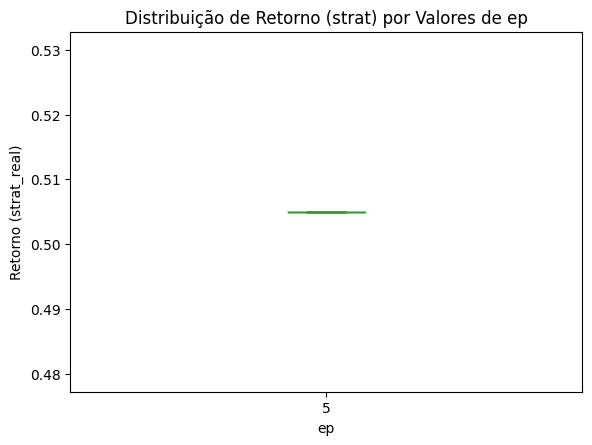

<Figure size 800x600 with 0 Axes>

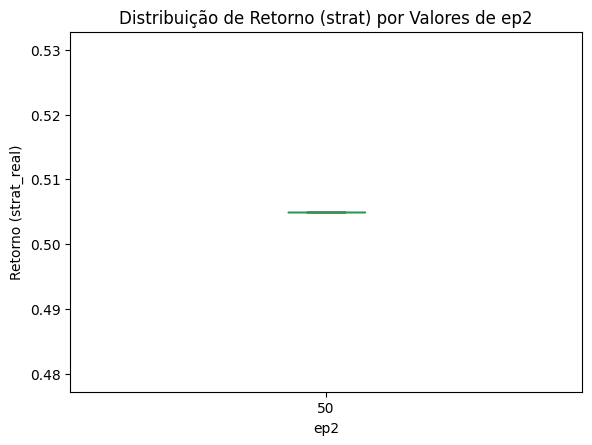

<Figure size 800x600 with 0 Axes>

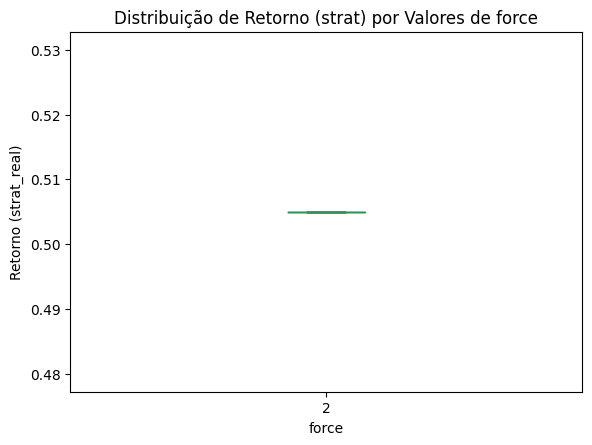

<Figure size 800x600 with 0 Axes>

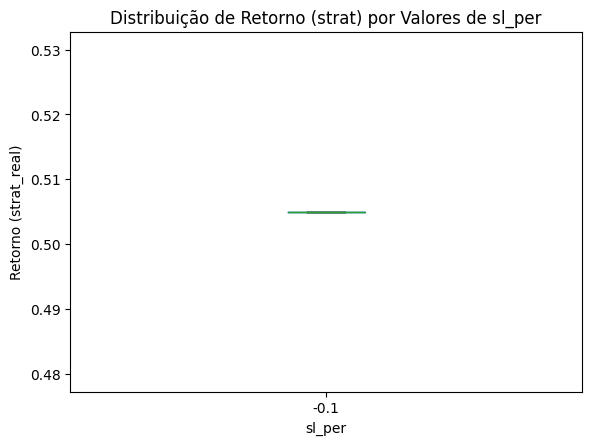

In [22]:
analise_distribuicao(df_res_test, 'strat_real')


In [23]:
# importancia_parametros = analise_sensibilidade_parametros(df_res_test)
# importancia_parametros

In [24]:

df_result = df_res_test.iloc[0].r
df_result.describe()

,start_index_m5,count,trigger_type,strategy,strategy_no_tc,total_opened,trail_stop_trigger,stop_loss_percent,trailing_stop_target,trailing_stop_loss,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,strategy_real
count,324.000000,324.000000,324.0,324.000000,324.000000,324.000000,324.000000,3.240000e+02,324.000000,324.000000,324.000000,324.000000,324.000000,324.000000,324.000000,324,324,324.000000
mean,179062.685185,780.867284,0.0,0.001559,0.002181,1.407407,0.330247,-1.000000e-01,0.059192,0.001484,6.961515,6.945130,0.500000,0.500000,0.012614,2024-05-06 15:00:33.148148224,2024-05-06 02:00:41.111111168,0.001559
min,2716.000000,7.000000,0.0,-0.022566,-0.021766,1.000000,0.000000,-1.000000e-01,0.050000,-0.010000,3.977000,3.968000,0.000000,0.000000,-0.157000,2024-01-04 15:01:00,2024-01-04 14:54:00,-0.022566
25%,77771.750000,75.750000,0.0,-0.011168,-0.010368,1.000000,0.000000,-1.000000e-01,0.050000,-0.010000,6.110250,6.106000,0.000000,0.000000,-0.073000,2024-02-26 09:12:45,2024-02-25 17:49:45,-0.011168
50%,153752.000000,196.000000,0.0,-0.006117,-0.005317,1.000000,0.000000,-1.000000e-01,0.050000,-0.010000,6.867000,6.865500,0.500000,0.500000,-0.036500,2024-04-18 13:09:00,2024-04-18 12:10:00,-0.006117
75%,270093.750000,744.750000,0.0,0.000200,0.000320,2.000000,1.000000,-1.000000e-01,0.050000,0.001000,7.698500,7.704500,1.000000,1.000000,0.002000,2024-07-08 17:51:00,2024-07-08 07:11:45,0.000200
max,434717.000000,21865.000000,0.0,0.144928,0.145728,3.000000,1.000000,-1.000000e-01,0.253125,0.142444,11.296000,11.410000,1.000000,1.000000,1.125000,2024-10-30 17:09:00,2024-10-30 14:55:00,0.144928
std,117515.048088,1769.062011,0.0,0.023397,0.023416,0.568040,0.471029,1.389925e-17,0.030390,0.024101,1.653152,1.659979,0.500773,0.500773,0.164016,NaN,NaN,0.023397


In [25]:


neg = df_result[df_result['strategy_real']<0]
pos = df_result[df_result['strategy_real']>0]
neutro = df_result[(df_result['strategy_real'] > 0.00015) & (df_result['strategy_real'] < 0.00025)]

print(len(neg), len(pos), len(neutro))
print(neg.strategy_real.sum(), pos.strategy_real.sum(), neutro.strategy_real.sum())

214 110 43
-2.0068107574150478 2.512085837144201 0.008635426466295672


In [26]:
df_result.sort_values(by='start_time').head()

,running,start_index_m5,count,trigger_type,strategy,strategy_no_tc,total_opened,first_return,trail_stop_trigger,stop_loss_percent,trailing_stop_target,trailing_stop_loss,type,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,strategy_real
0,False,2716,8,0,-0.007691,-0.006891,1,False,0,-0.1,0.050,-0.010000,sell,7.809,7.863,0,1,-0.054,2024-01-04 15:01:00,2024-01-04 14:54:00,-0.007691
1,False,3122,247,0,-0.010513,-0.009713,1,False,0,-0.1,0.050,-0.010000,buy,7.863,7.787,1,0,-0.076,2024-01-05 01:46:00,2024-01-04 21:40:00,-0.010513
2,False,3486,1192,0,0.032237,0.033037,1,False,1,-0.1,0.075,0.033954,sell,7.693,7.443,0,1,0.250,2024-01-05 23:35:00,2024-01-05 03:44:00,0.032237
3,False,7041,29,0,-0.012475,-0.011675,1,False,0,-0.1,0.050,-0.010000,buy,7.237,7.153,1,0,-0.084,2024-01-07 15:27:00,2024-01-07 14:59:00,-0.012475
4,False,7411,178,0,0.031214,0.032014,1,False,1,-0.1,0.075,0.033448,sell,7.173,6.947,0,1,0.226,2024-01-08 00:06:00,2024-01-07 21:09:00,0.031214


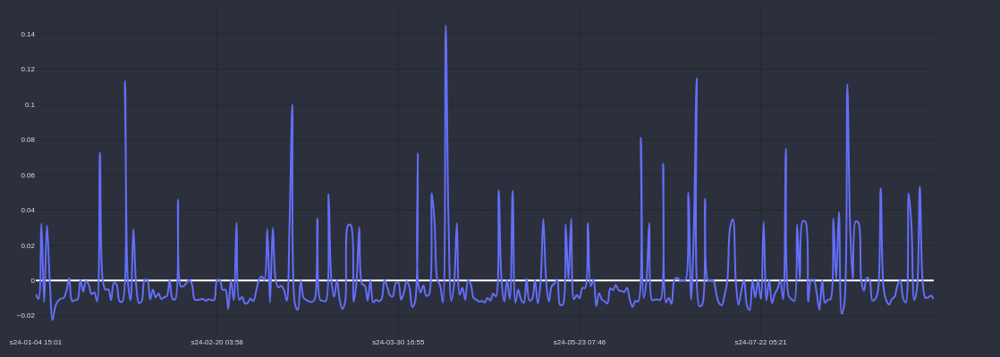

IndexError: single positional indexer is out-of-bounds

In [27]:
for i in range(8):
    df_result1 = df_res_test.iloc[i].r
    df_result1['time'] = df_result1['end_time']
    cp = CandlePlot(df_result1,candles=False)
    cp.show_plot(line_traces=['strategy_real'])

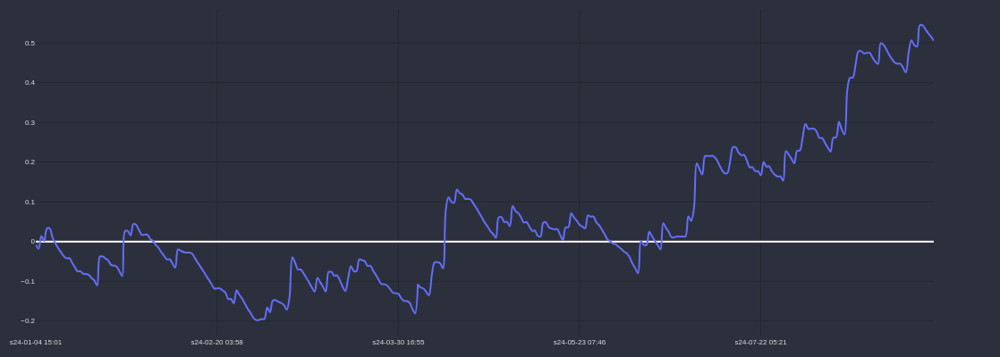

IndexError: single positional indexer is out-of-bounds

In [28]:
for i in range(8):
    df_result1 = df_res_test.iloc[i].r
    df_result1['time'] = df_result1['end_time']
    df_result1['gain'] = df_result1['strategy_real'].cumsum()
    cp = CandlePlot(df_result1,candles=False)
    cp.show_plot(line_traces=['gain'])

In [29]:
# ddf = lista[3]['res'].df.copy()
# ddf = lista[0]['res'].copy()
ddf = df_res_test.iloc[0]['df'].copy()
ddf.columns

Index(['Time', 'Open', 'High', 'Low', 'Close', 'Volume', 'time', 'strategy',
       'returns', 'creturns', 'Log_Returns', 'cLog_Returns', 'EMA_short',
       'EMA_long', 'EMA_long_delta', 'Percent_Change_1', 'EMA_percent_s_1',
       'Percent_Change_super_long', 'Average_EMA_percent_ema_super_long',
       'donchian_high', 'donchian_low', 'donchian_mid', 'donchian_75',
       'donchian_87', 'donchian_62', 'donchian_25', 'donchian_37',
       'donchian_12', '+DI', '-DI', 'ADX', 'RSI', 'percent_stop_loss',
       'SIGNAL_UP', 'SIGNAL_DOWN'],
      dtype='object')

In [30]:
df_result.trail_stop_trigger.value_counts()

trail_stop_trigger
0    217
1    107
Name: count, dtype: int64

In [31]:
df_result[df_result['strategy'] < 0].head(50)

,running,start_index_m5,count,trigger_type,strategy,strategy_no_tc,total_opened,first_return,trail_stop_trigger,stop_loss_percent,trailing_stop_target,trailing_stop_loss,type,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,strategy_real,time,gain
0,False,2716,8,0,-0.007691,-0.006891,1,False,0,-0.1,0.05,-0.01,sell,7.809,7.863,0,1,-0.054,2024-01-04 15:01:00,2024-01-04 14:54:00,-0.007691,2024-01-04 15:01:00,-0.007691
1,False,3122,247,0,-0.010513,-0.009713,1,False,0,-0.1,0.05,-0.01,buy,7.863,7.787,1,0,-0.076,2024-01-05 01:46:00,2024-01-04 21:40:00,-0.010513,2024-01-05 01:46:00,-0.018204
3,False,7041,29,0,-0.012475,-0.011675,1,False,0,-0.1,0.05,-0.01,buy,7.237,7.153,1,0,-0.084,2024-01-07 15:27:00,2024-01-07 14:59:00,-0.012475,2024-01-07 15:27:00,0.001558
6,False,10284,11,0,-0.022566,-0.021766,1,False,0,-0.1,0.05,-0.01,sell,6.953,7.106,0,1,-0.153,2024-01-09 21:12:00,2024-01-09 21:02:00,-0.022566,2024-01-09 21:12:00,0.010406
7,False,11750,11,0,-0.014799,-0.013999,1,False,0,-0.1,0.05,-0.01,buy,7.697,7.590,1,0,-0.107,2024-01-10 21:38:00,2024-01-10 21:28:00,-0.014799,2024-01-10 21:38:00,-0.004393
8,False,13985,100,0,-0.011683,-0.010883,1,False,0,-0.1,0.05,-0.01,sell,8.042,8.130,0,1,-0.088,2024-01-12 12:22:00,2024-01-12 10:43:00,-0.011683,2024-01-12 12:22:00,-0.016076
9,False,16756,173,0,-0.010379,-0.009579,1,False,0,-0.1,0.05,-0.01,buy,7.657,7.584,1,0,-0.073,2024-01-14 11:46:00,2024-01-14 08:54:00,-0.010379,2024-01-14 11:46:00,-0.026456
10,False,16973,127,0,-0.009988,-0.009188,2,False,0,-0.1,0.05,-0.01,sell,7.584,7.654,0,1,-0.070,2024-01-14 14:37:00,2024-01-14 12:31:00,-0.009988,2024-01-14 14:37:00,-0.036443
11,False,17099,20,0,-0.005908,-0.005108,2,False,0,-0.1,0.05,-0.01,buy,7.654,7.615,1,0,-0.039,2024-01-14 14:56:00,2024-01-14 14:37:00,-0.005908,2024-01-14 14:56:00,-0.042352
13,False,18266,159,0,-0.011723,-0.010923,1,False,0,-0.1,0.05,-0.01,buy,7.640,7.557,1,0,-0.083,2024-01-15 12:42:00,2024-01-15 10:04:00,-0.011723,2024-01-15 12:42:00,-0.052903


20 20


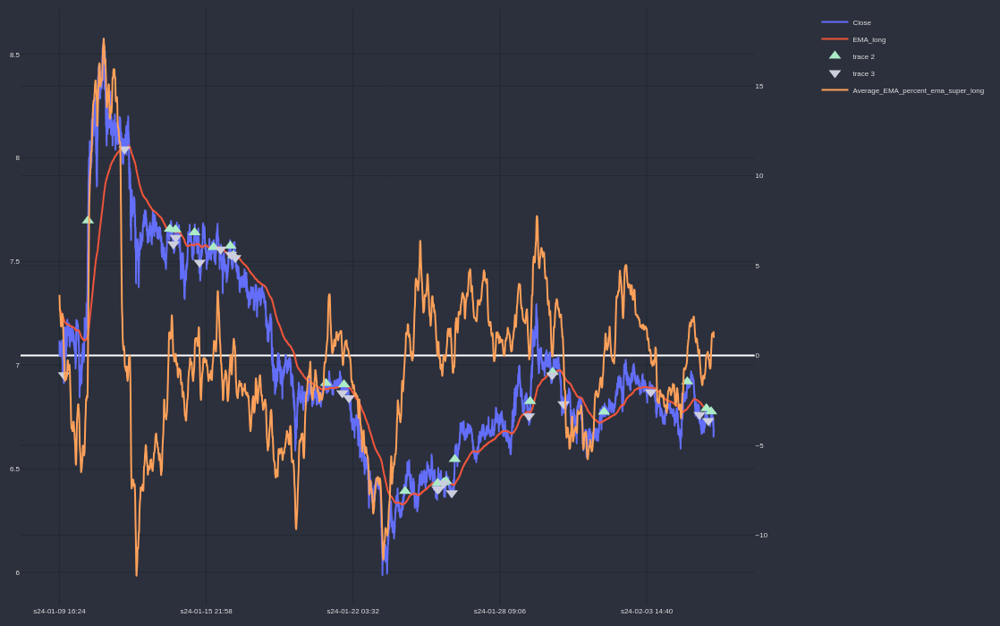

In [32]:
cp = CandlePlot(ddf.iloc[10006:50006],candles=False)


trades_up = cp.df_plot[cp.df_plot.SIGNAL_UP == 1]

trades_down = cp.df_plot[cp.df_plot.SIGNAL_DOWN == 1]

print(len(trades_up),len(trades_down))



marker_trade_up = '#abebc6'
marker_trade_down = '#cccddd'


markers = 'Close'


cp.add_traces(['Close','EMA_long'])


# # SIGNAL UP
cp.fig.add_trace(go.Scatter(
    x = trades_up.sTime,
    y = trades_up[markers],
    mode = 'markers',
    marker_symbol = 'triangle-up',
    marker=dict(color=marker_trade_up, size=12)
))

cp.fig.add_trace(go.Scatter(
    x = trades_down.sTime,
    y = trades_down[markers],
    mode = 'markers',
    marker_symbol = 'triangle-down',
    marker=dict(color=marker_trade_down, size=12)
))


cp.show_plot(height=700, width=1100, sec_traces=['Average_EMA_percent_ema_super_long'])

In [33]:
# cp = CandlePlot(ddf.iloc[0:20000],candles=False, is_subplots=False)

# cp.add_traces(['Close'])
# cp.show_plot(height=700, width=1100, sec_traces=['Average_EMA_percent_ema_short','Average_EMA_percent_ema_long'])

In [46]:
df_result.columns

Index(['running', 'start_index_m5', 'count', 'trigger_type', 'strategy',
       'strategy_no_tc', 'total_opened', 'first_return', 'trail_stop_trigger',
       'stop_loss_percent', 'trailing_stop_target', 'trailing_stop_loss',
       'type', 'start_price', 'trigger_price', 'SIGNAL_UP', 'SIGNAL_DOWN',
       'result', 'end_time', 'start_time', 'strategy_real', 'time', 'gain'],
      dtype='object')

In [47]:
df_result[df_result['start_time'] == '2024-09-27 02:33:00']

,running,start_index_m5,count,trigger_type,strategy,strategy_no_tc,total_opened,first_return,trail_stop_trigger,stop_loss_percent,trailing_stop_target,trailing_stop_loss,type,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,strategy_real,time,gain


In [48]:
df = res[0]['res'].df
df.columns

Index(['Time', 'Open', 'High', 'Low', 'Close', 'Volume', 'time', 'strategy',
       'returns', 'creturns', 'Log_Returns', 'cLog_Returns', 'EMA_short',
       'EMA_long', 'Percent_Change_1', 'EMA_percent_s_1', 'Percent_Change_10',
       'EMA_percent_s_10', 'Percent_Change_50', 'EMA_percent_s_50',
       'Percent_Change_100', 'EMA_percent_s_100_5', 'EMA_percent_s_100_10',
       'EMA_percent_s_100_15', 'Percent_Change_150', 'EMA_percent_s_150_5',
       'EMA_percent_s_150_10', 'EMA_percent_s_150_15', 'Percent_Change_200',
       'EMA_percent_s_200_5', 'EMA_percent_s_200_10', 'EMA_percent_s_200_15',
       'Percent_Change_500', 'EMA_percent_s_500_5', 'Percent_Change_1000',
       'EMA_percent_s_1000_5', 'Percent_Change_2000', 'EMA_percent_s_2000_5',
       'Percent_Change_3000', 'EMA_percent_s_3000_5', 'Average_EMA_percent',
       'Average_EMA_percent_ema_short', 'Average_EMA_percent_ema_long',
       'Average_EMA_percent_ema_1', 'Average_EMA_percent_ema_5',
       'Average_EMA_percent_

In [49]:
index = df[df['time']=='2024-09-27 02:33:00'].index[0]
print(index)

209215


In [50]:
df_test = df.iloc[index:index+20]
df_test['strategy'] = df_test.returns.cumsum()
df_test['strategy2'] = (1 + df_test['returns']).cumprod() - 1
df_test[['Time', 'Close', 'Volume', 'strategy','strategy2','returns']]

,Time,Close,Volume,strategy,strategy2,returns
209215,2024-09-27 02:33:00,4.869,5695.38,4.108463e-04,0.000411,0.000411
209216,2024-09-27 02:34:00,4.870,3505.21,6.162062e-04,0.000616,0.000205
209217,2024-09-27 02:35:00,4.874,484.93,1.437224e-03,0.001438,0.000821
209218,2024-09-27 02:36:00,4.871,639.44,8.215240e-04,0.000821,-0.000616
209219,2024-09-27 02:37:00,4.866,2883.72,-2.054865e-04,-0.000207,-0.001027
209220,2024-09-27 02:38:00,4.864,3530.05,-6.165862e-04,-0.000618,-0.000411
209221,2024-09-27 02:39:00,4.867,399.68,1.717376e-16,-0.000001,0.000617
209222,2024-09-27 02:40:00,4.874,3016.60,1.437224e-03,0.001436,0.001437
209223,2024-09-27 02:41:00,4.874,1078.19,1.437224e-03,0.001436,0.000000
209224,2024-09-27 02:42:00,4.874,511.19,1.437224e-03,0.001436,0.000000


In [51]:
result = df_test['Close'].iloc[-1] - df_test['Close'].iloc[0]
round(result,4)

np.float64(0.004)

# Comparação de series temporais

Maior correlação em lag: -5


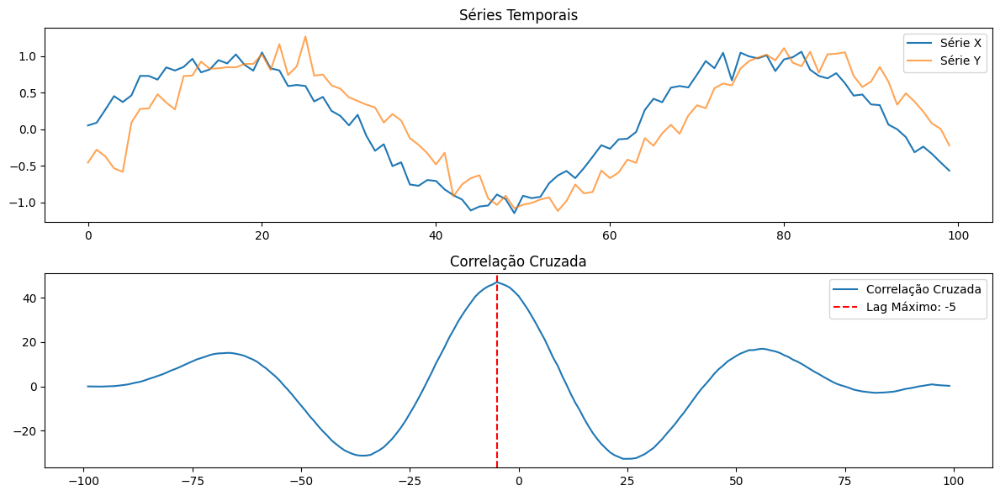

In [472]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import correlate

# Séries temporais
np.random.seed(42)
x = np.sin(np.linspace(0, 10, 100)) + np.random.normal(scale=0.1, size=100)
y = np.roll(x, shift=5) + np.random.normal(scale=0.1, size=100)

# Correlação cruzada
lags = np.arange(-len(x) + 1, len(x))
correlation = correlate(x, y, mode="full")

# Encontrar o lag com maior correlação
lag_max = lags[np.argmax(correlation)]
print(f"Maior correlação em lag: {lag_max}")

# Gráfico
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.plot(x, label="Série X")
plt.plot(y, label="Série Y", alpha=0.7)
plt.title("Séries Temporais")
plt.legend()

plt.subplot(2, 1, 2)
plt.plot(lags, correlation, label="Correlação Cruzada")
plt.axvline(lag_max, color="red", linestyle="--", label=f"Lag Máximo: {lag_max}")
plt.title("Correlação Cruzada")
plt.legend()
plt.tight_layout()
plt.show()


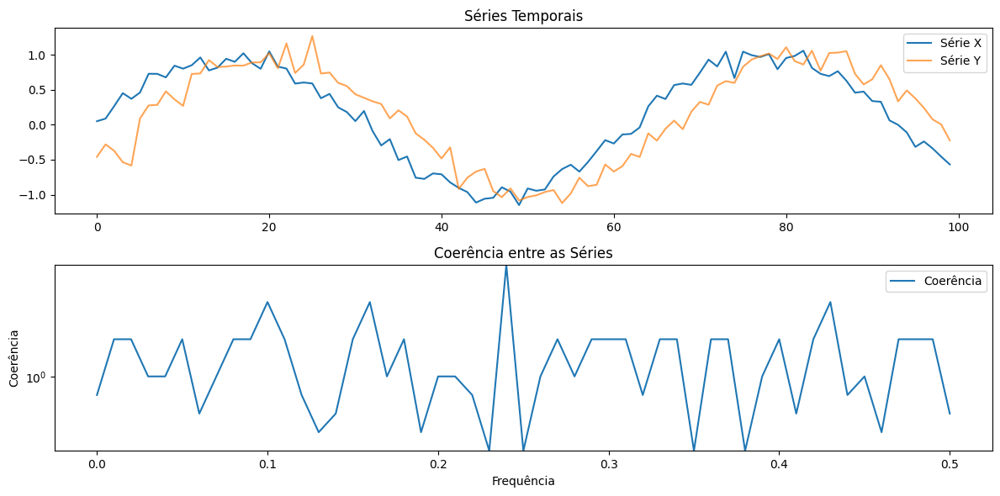

In [473]:
from scipy.signal import coherence

# Coerência entre as séries
f, Cxy = coherence(x, y, fs=1.0)

# Gráfico
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.plot(x, label="Série X")
plt.plot(y, label="Série Y", alpha=0.7)
plt.title("Séries Temporais")
plt.legend()

plt.subplot(2, 1, 2)
plt.semilogy(f, Cxy, label="Coerência")
plt.title("Coerência entre as Séries")
plt.xlabel("Frequência")
plt.ylabel("Coerência")
plt.legend()
plt.tight_layout()
plt.show()


In [474]:
# from fastdtw import fastdtw
# from scipy.spatial.distance import euclidean

# # DTW entre as séries
# distance, path = fastdtw(x, y, dist=euclidean)
# print(f"Distância DTW: {distance}")

# # Gráfico
# plt.figure(figsize=(12, 6))
# plt.subplot(2, 1, 1)
# plt.plot(x, label="Série X")
# plt.plot(y, label="Série Y", alpha=0.7)
# plt.title("Séries Temporais")
# plt.legend()

# plt.subplot(2, 1, 2)
# plt.plot([p[0] for p in path], [p[1] for p in path], marker="o", linestyle="--")
# plt.title("Caminho DTW")
# plt.xlabel("Índices da Série X")
# plt.ylabel("Índices da Série Y")
# plt.tight_layout()
# plt.show()


Janelas com alta correlação: [0, 1, 2, 3, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 76, 77, 78, 79, 80]


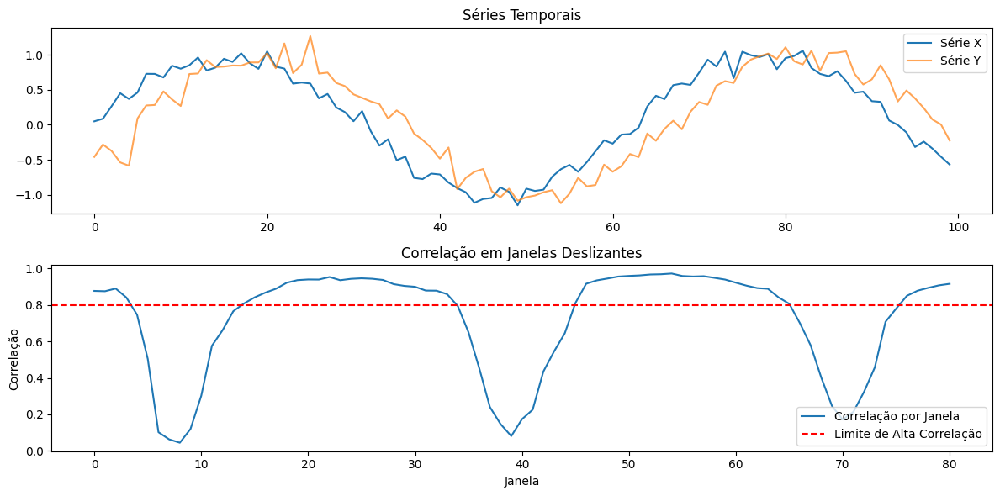

In [475]:
import pandas as pd

# Função para correlação em janelas
window_size = 20
correlations = [np.corrcoef(x[i:i+window_size], y[i:i+window_size])[0, 1] 
                for i in range(len(x) - window_size + 1)]

# Identificar janelas com alta correlação
high_corr_windows = [i for i, c in enumerate(correlations) if c > 0.8]
print(f"Janelas com alta correlação: {high_corr_windows}")

# Gráfico
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.plot(x, label="Série X")
plt.plot(y, label="Série Y", alpha=0.7)
plt.title("Séries Temporais")
plt.legend()

plt.subplot(2, 1, 2)
plt.plot(range(len(correlations)), correlations, label="Correlação por Janela")
plt.axhline(0.8, color="red", linestyle="--", label="Limite de Alta Correlação")
plt.title("Correlação em Janelas Deslizantes")
plt.xlabel("Janela")
plt.ylabel("Correlação")
plt.legend()
plt.tight_layout()
plt.show()


Informação Mútua: 0.9068418891231994


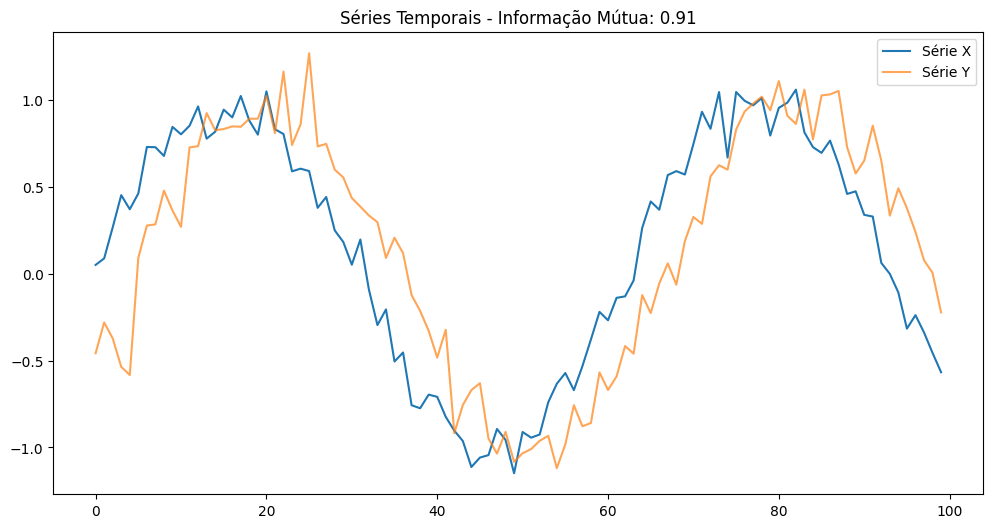

In [476]:
from sklearn.metrics import mutual_info_score

# Discretizar as séries para calcular mutual information
bins = 10
x_digitized = np.digitize(x, bins=np.histogram_bin_edges(x, bins=bins))
y_digitized = np.digitize(y, bins=np.histogram_bin_edges(y, bins=bins))
mi = mutual_info_score(x_digitized, y_digitized)
print(f"Informação Mútua: {mi}")

# Gráfico
plt.figure(figsize=(12, 6))
plt.plot(x, label="Série X")
plt.plot(y, label="Série Y", alpha=0.7)
plt.title(f"Séries Temporais - Informação Mútua: {mi:.2f}")
plt.legend()
plt.show()


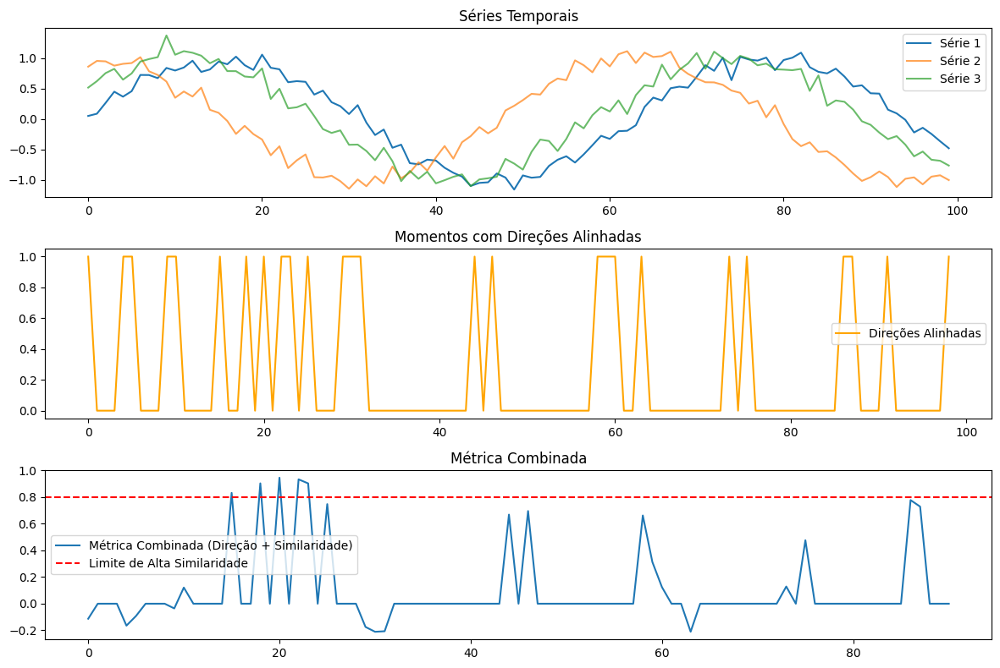

In [477]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import correlate

# Simulando três séries temporais caóticas
np.random.seed(42)
time = np.arange(0, 100)
series1 = np.sin(time / 10) + np.random.normal(scale=0.1, size=100)
series2 = np.cos(time / 10) + np.random.normal(scale=0.1, size=100)
series3 = np.sin(time / 10 + 0.5) + np.random.normal(scale=0.1, size=100)

# Função para calcular direções (diferenças consecutivas)
def calculate_directions(series):
    return np.sign(np.diff(series))

# Direções para as três séries
dir1 = calculate_directions(series1)
dir2 = calculate_directions(series2)
dir3 = calculate_directions(series3)

# Identificar momentos em que todas têm a mesma direção
aligned_directions = (dir1 == dir2) & (dir2 == dir3)

# Métrica de similaridade: Correlação por janelas
window_size = 10
similarities = []
for i in range(len(series1) - window_size + 1):
    corr12 = np.corrcoef(series1[i:i+window_size], series2[i:i+window_size])[0, 1]
    corr13 = np.corrcoef(series1[i:i+window_size], series3[i:i+window_size])[0, 1]
    corr23 = np.corrcoef(series2[i:i+window_size], series3[i:i+window_size])[0, 1]
    avg_corr = np.mean([corr12, corr13, corr23])
    similarities.append(avg_corr)

# Combinar alinhamento direcional e similaridade
combined_metric = np.array(similarities) * aligned_directions[:len(similarities)]

# Plotar as séries temporais
plt.figure(figsize=(12, 8))
plt.subplot(3, 1, 1)
plt.plot(time, series1, label="Série 1")
plt.plot(time, series2, label="Série 2", alpha=0.7)
plt.plot(time, series3, label="Série 3", alpha=0.7)
plt.title("Séries Temporais")
plt.legend()

# Plotar direções alinhadas
plt.subplot(3, 1, 2)
plt.plot(aligned_directions, label="Direções Alinhadas", color="orange")
plt.title("Momentos com Direções Alinhadas")
plt.legend()

# Plotar métrica combinada
plt.subplot(3, 1, 3)
plt.plot(combined_metric, label="Métrica Combinada (Direção + Similaridade)")
plt.axhline(0.8, color="red", linestyle="--", label="Limite de Alta Similaridade")
plt.title("Métrica Combinada")
plt.legend()
plt.tight_layout()
plt.show()


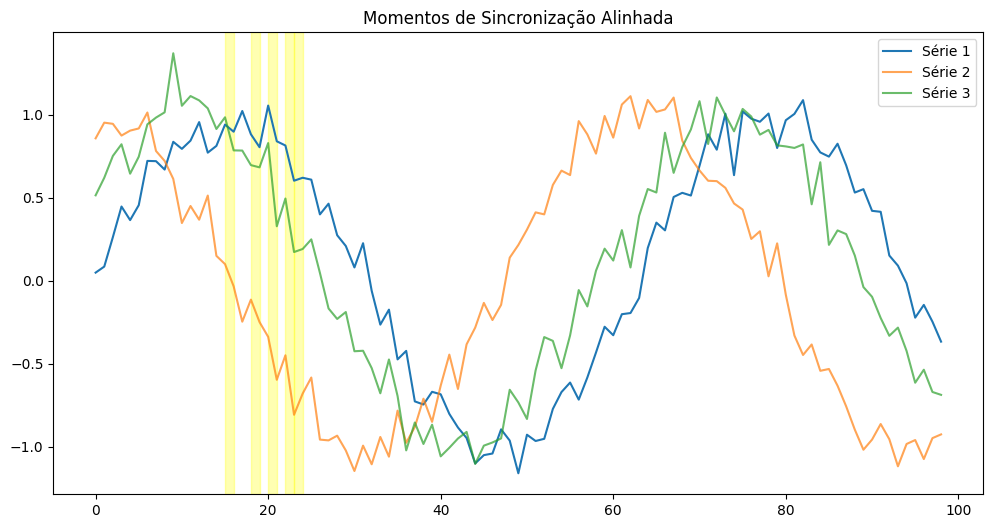

In [478]:
# Momentos de alta sincronização (combined_metric > 0.8)
high_sync = combined_metric > 0.8

# Plotar as séries com realce nos momentos sincronizados
plt.figure(figsize=(12, 6))
plt.plot(time[:-1], series1[:-1], label="Série 1")
plt.plot(time[:-1], series2[:-1], label="Série 2", alpha=0.7)
plt.plot(time[:-1], series3[:-1], label="Série 3", alpha=0.7)

# Destacar momentos de sincronização
for i in range(len(high_sync)):
    if high_sync[i]:
        plt.axvspan(time[i], time[i+1], color="yellow", alpha=0.3)

plt.title("Momentos de Sincronização Alinhada")
plt.legend()
plt.show()


In [479]:
import numpy as np
import pandas as pd

def analyze_series_with_windows(df, col1, col2, col3, window_size=20, direction_tolerance=0.05, slope_tolerance=0.1):
    """
    Analisa alinhamento de direção e inclinação rigorosamente entre três séries temporais
    utilizando janelas móveis.

    Args:
        df (pd.DataFrame): DataFrame contendo as séries temporais.
        col1, col2, col3 (str): Nomes das colunas das séries temporais.
        window_size (int): Tamanho da janela para análise.
        direction_tolerance (float): Tolerância para variação direcional.
        slope_tolerance (float): Tolerância para inclinação relativa.

    Returns:
        pd.DataFrame: DataFrame atualizado com as colunas 'aligned_directions' e 'combined_metric'.
    """
    def calculate_directions_and_slopes(window):
        """Calcula direção (+/-) e inclinação (diferenças normalizadas) em uma janela."""
        deltas = np.diff(window)
        directions = np.sign(deltas)
        normalized_slopes = deltas / (np.abs(deltas).mean() + 1e-6)  # Normalização para comparar
        return directions, normalized_slopes

    # Inicializar métricas
    aligned_directions = []
    combined_metric = []

    # Percorrer a série em janelas deslizantes
    for i in range(len(df) - window_size):
        # Extrair janelas
        window1 = df[col1].iloc[i:i + window_size].values
        window2 = df[col2].iloc[i:i + window_size].values
        window3 = df[col3].iloc[i:i + window_size].values

        # Calcular direções e inclinações para cada janela
        dir1, slope1 = calculate_directions_and_slopes(window1)
        dir2, slope2 = calculate_directions_and_slopes(window2)
        dir3, slope3 = calculate_directions_and_slopes(window3)

        # Verificar alinhamento de direção
        direction_alignment = (
            (np.abs(dir1 - dir2) <= direction_tolerance).all() &
            (np.abs(dir2 - dir3) <= direction_tolerance).all() &
            (np.abs(dir1 - dir3) <= direction_tolerance).all()
        )

        # Verificar inclinação semelhante
        slope_alignment = (
            (np.abs(slope1 - slope2) <= slope_tolerance).all() &
            (np.abs(slope2 - slope3) <= slope_tolerance).all() &
            (np.abs(slope1 - slope3) <= slope_tolerance).all()
        )

        # Combinar métricas (0 ou 1)
        aligned_directions.append(int(direction_alignment))
        combined_metric.append(int(direction_alignment and slope_alignment))

    # Ajustar tamanhos para adicionar ao DataFrame
    aligned_directions_full = [0] * (window_size - 1) + aligned_directions + [0]
    combined_metric_full = [0] * (window_size - 1) + combined_metric + [0]

    # Adicionar ao DataFrame
    df['aligned_directions'] = aligned_directions_full
    df['combined_metric'] = combined_metric_full
    
    return df


In [480]:


df = analyze_series_with_windows(ddf.iloc[0:10000], 'EMA_percent_s_100_5','EMA_percent_s_150_5','EMA_percent_s_200_5', window_size=10, direction_tolerance=0.2, slope_tolerance=0.2)



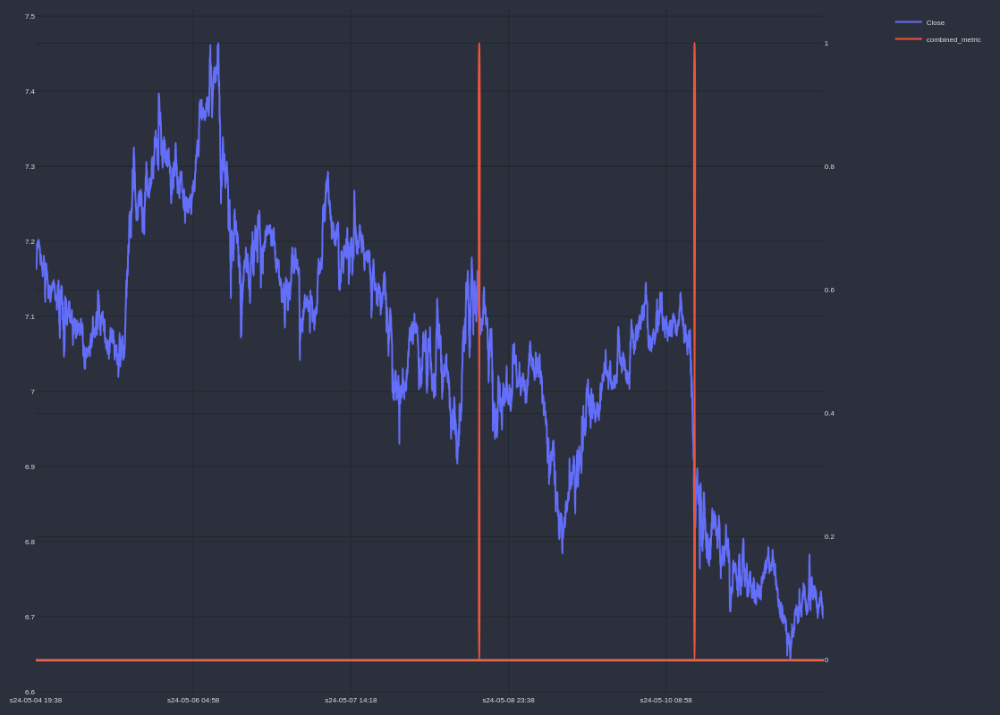

In [481]:
cp = CandlePlot(df,candles=False)
cp.show_plot(height=800,line_traces=['Close'],sec_traces=['combined_metric'])

In [518]:
import numpy as np
import pandas as pd

def analyze_series_similarity(df, col1, col2, col3, window_size=20, curvature_threshold=0.05, magnitude_tolerance=0.1, shape_correlation_threshold=0.9):
    """
    Analisa movimentos similares entre três séries temporais com base em curvatura, magnitude e forma.

    Args:
        df (pd.DataFrame): DataFrame contendo as séries temporais.
        col1, col2, col3 (str): Nomes das colunas das séries temporais.
        window_size (int): Tamanho da janela para análise.
        curvature_threshold (float): Limite mínimo para identificar curvatura significativa.
        magnitude_tolerance (float): Tolerância para diferenças em magnitude.
        shape_correlation_threshold (float): Limite mínimo de correlação para padrões similares.

    Returns:
        pd.DataFrame: DataFrame atualizado com as colunas 'similarity_metric' e 'similarity_sync'.
    """
    def calculate_curvature(series):
        """Calcula a segunda derivada aproximada (curvatura) de uma série."""
        first_derivative = np.diff(series)
        second_derivative = np.diff(first_derivative)
        curvature = np.append([0, 0], second_derivative)  # Ajustar para tamanho original
        return curvature

    def is_magnitude_similar(series1, series2, tolerance):
        """Verifica se as magnitudes das duas séries estão dentro da tolerância."""
        diff = np.abs(series1 - series2)
        return np.all(diff <= tolerance)

    def is_shape_similar(window1, window2, threshold):
        """Verifica se as formas das duas séries são semelhantes usando correlação."""
        correlation = np.corrcoef(window1, window2)[0, 1]
        return correlation >= threshold

    # Calcular curvaturas para cada série
    curvature1 = calculate_curvature(df[col1])
    curvature2 = calculate_curvature(df[col2])
    curvature3 = calculate_curvature(df[col3])

    # Inicializar métricas
    similarity_metric = []
    similarity_sync = []

    # Analisar janelas deslizantes
    for i in range(len(df) - window_size):
        # Extrair janelas
        window1 = df[col1].iloc[i:i + window_size].values
        window2 = df[col2].iloc[i:i + window_size].values
        window3 = df[col3].iloc[i:i + window_size].values

        # Verificar curvatura significativa
        curv1 = np.abs(curvature1[i:i + window_size]) > curvature_threshold
        curv2 = np.abs(curvature2[i:i + window_size]) > curvature_threshold
        curv3 = np.abs(curvature3[i:i + window_size]) > curvature_threshold

        if np.any(curv1) and np.any(curv2) and np.any(curv3):
            # Verificar semelhança de magnitude
            mag12 = is_magnitude_similar(window1, window2, magnitude_tolerance)
            mag13 = is_magnitude_similar(window1, window3, magnitude_tolerance)
            mag23 = is_magnitude_similar(window2, window3, magnitude_tolerance)

            # Verificar semelhança de forma
            shape12 = is_shape_similar(window1, window2, shape_correlation_threshold)
            shape13 = is_shape_similar(window1, window3, shape_correlation_threshold)
            shape23 = is_shape_similar(window2, window3, shape_correlation_threshold)

            # Determinar sincronização
            if mag12 and mag13 and mag23 and shape12 and shape13 and shape23:
                similarity_sync.append(1)
            else:
                similarity_sync.append(0)

            # Curvatura geral da janela
            similarity_metric.append(1)
        else:
            similarity_sync.append(0)
            similarity_metric.append(0)

    # Ajustar métricas para o tamanho do DataFrame
    similarity_metric_full = [0] * (window_size - 1) + similarity_metric + [0]
    similarity_sync_full = [0] * (window_size - 1) + similarity_sync + [0]

    # Adicionar resultados ao DataFrame
    df['similarity_metric'] = similarity_metric_full
    df['similarity_sync'] = similarity_sync_full
    
    return df


In [540]:



# Aplicar a função de análise de similaridade
df = analyze_series_similarity(
    ddf.iloc[0:10000], 
    'EMA_percent_s_100_5', 
    'EMA_percent_s_150_5', 
    'EMA_percent_s_200_5', 
    window_size=20, 
    curvature_threshold=0.05, 
    magnitude_tolerance=0.01, 
    shape_correlation_threshold=0.01
)


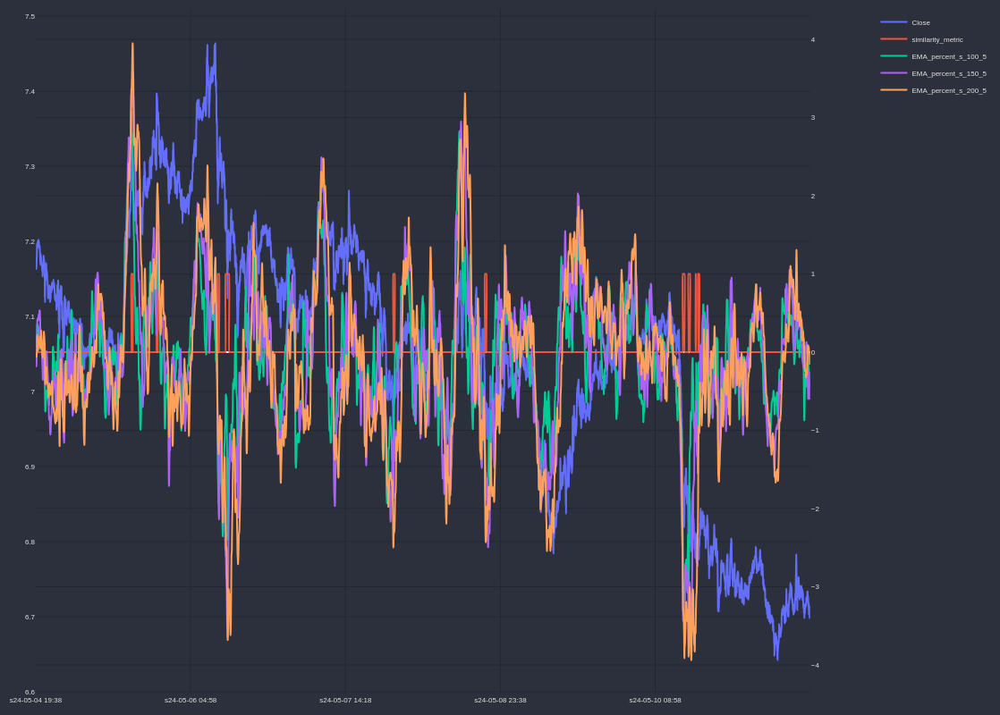

In [541]:


cp = CandlePlot(df,candles=False)
cp.show_plot(height=800,line_traces=['Close'],sec_traces=['similarity_metric','EMA_percent_s_100_5','EMA_percent_s_150_5','EMA_percent_s_200_5'])


